In [1]:
import sys
import os
sys.path.append(os.path.abspath('').split('LiverStagePipeline')[-2] + 'LiverStagePipeline')

import numpy as np
import pandas as pd

import torch
import torch.optim as optim
from torch.utils.data import DataLoader

import get_models as get_models
from segmentation.AI.datasets import MicroscopyDataset
from segmentation.evaluate import Inferenceinator
from segmentation.conventional.cell_watershed import segment_cells_in_folder as conv_seg


from utils import setup, data_utils, cell_viewer
from feature_analysis import features, plot_features
from feature_analysis.cell_dataset import CellDataset
from feature_analysis.VAE_models import VAE
from feature_analysis.train import train_VAE
from feature_analysis import inference, dimensionality_reduction, plot_lowdim, evaluate_clusters

torch.set_default_dtype(torch.float64)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 
if not torch.cuda.is_available():
    print("Using non-cuda device: {}".format(device))

In [2]:
# Global settings
session_name = 'FoI_1'#'FoI_1''6c'
pipeline_files_folder = '/mnt/DATA1/anton/pipeline_files'

hsp_channel, dapi_channel = 1, 0 # lowres
threads = 20

In [3]:
paths = setup.setup(pipeline_files_folder, session_name=session_name)

# Segmentation

In [4]:
# settings
model_path = '/mnt/DATA1/anton/pipeline_files/segmentation/models/best_model.pth'
segmentation_batch_size = 10

tif_folder = '/mnt/DATA1/anton/data/force_of_infection/tifs'

In [5]:
image_paths = data_utils.get_paths(tif_folder) # list of paths to tif files
channels = [[dapi_channel, hsp_channel] for img_path in image_paths]

In [6]:
# # parasite segmentation
# segmentation_model, segmentation_model_output_parser = get_models.maskrcnn()
# segmentation_model.load_state_dict(torch.load(model_path))
# segmentation_model.to(device)

# image_dataset = MicroscopyDataset(image_paths=image_paths, channels=channels, groups=None, folder_normalize=True, rescale_img=(1040, 1392))
# image_loader = torch.utils.data.DataLoader(image_dataset, batch_size=segmentation_batch_size, num_workers=segmentation_batch_size, shuffle=True, collate_fn=data_utils.collate_fn)

# test_evaluator = Inferenceinator(image_loader, segmentation_model_output_parser, processes=segmentation_batch_size, evaluate=False, device=device)
# res = test_evaluator(segmentation_model, store_folder=paths['parasite_masks_folder'])

In [7]:
# # hepatocyte segmentation
# image_paths, parasite_mask_paths = data_utils.get_two_sets(tif_folder, paths['parasite_masks_folder'], common_subset=True, return_paths=True)
# assert len(image_paths) == len(channels)
# DAPI_channels = [dapi_channel] * len(image_paths)
# conv_seg(image_paths=image_paths, segmentation_folder=paths['hepatocyte_masks_folder'], parasite_mask_paths=parasite_mask_paths, threads=threads, channels=DAPI_channels, resize_shape=None, normalize=False, equalize_adapthist=12)

/mnt/DATA1/anton/data/force_of_infection/tifs/NF54/4s1h/2019016/2019016_nf54_4to1_d5_hspgs_series_67_TileScan_001


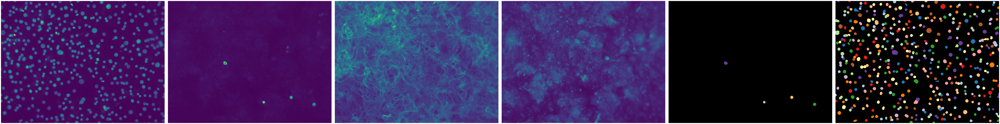

/mnt/DATA1/anton/data/force_of_infection/tifs/NF175/4s1h/2019005_2/2019005_175_4s-1h_series_34_TileScan_001


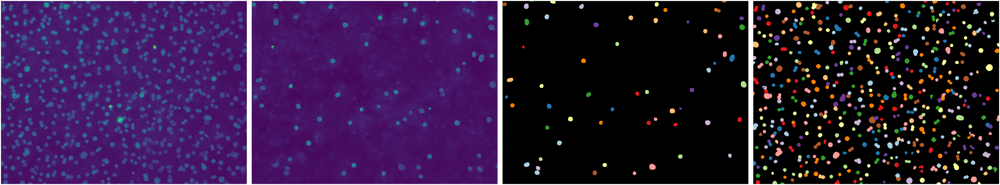

In [8]:
# visualization
cell_viewer.show_folder(tif_dir=tif_folder, seg_dirs=[paths['parasite_masks_folder'], paths['hepatocyte_masks_folder']], eval=False, num_rows=1, num_images=2)

# Feature extraction
Settings:
metadata_func: method that accepts a tif path and outputs relevant metadata (e.g. strain, day, resolution, etc.) in dictionary form. E.g. {'strain': 54, 'day': 7} feature_dict: dictionary indicating which features need to be computed, formatted as {ID: (name, feature_list)}, where ID is either the index of the channel or 'mask' for mask related features such as 'area' or 'solidity'. Name is the prefix for the computed feature in the final csv file. feature_list is a list of features. A feature_dict could be {'mask': ('', ['area', 'solidity']), 1: ('hsp', ['max_intensity', 'min_intensity'])}

In [9]:
# settings
feature_dict = features.default_feature_dict(hsp_channel=hsp_channel, dapi_channel=dapi_channel)

def foi_metadata(tif_path):
    return {'strain': int(tif_path.split('/')[7][2:]), 'foi': tif_path.split('/')[8], 'foi_ratio': int(tif_path.split('/')[8].strip('h').split('s')[0]) / int(tif_path.split('/')[8].strip('h').split('s')[1])}

metadata_func = foi_metadata

print(feature_dict)

{'mask': ('', ['area', 'area_convex', 'area_filled', 'axis_major_length', 'axis_minor_length', 'eccentricity', 'equivalent_diameter_area', 'extent', 'feret_diameter_max', 'perimeter', 'perimeter_crofton', 'solidity', 'avg_(1)_neighbours_distance', 'avg_(3)_neighbours_distance', 'avg_(5)_neighbours_distance', 'avg_(7)_neighbours_distance', 'parasites_within_(100)px', 'parasites_within_(300)px', 'parasites_within_(600)px', 'parasites_within_(900)px', 'parasites_within_(1200)px', 'parasites_within_(2000)px', 'avg_(1)_nearest_hepatocytes_distance', 'avg_(3)_nearest_hepatocytes_distance', 'avg_(5)_nearest_hepatocytes_distance', 'avg_(7)_nearest_hepatocytes_distance', 'avg_(10)_nearest_hepatocytes_distance', 'avg_(15)_nearest_hepatocytes_distance', 'avg_(20)_nearest_hepatocytes_distance', 'avg_(50)_nearest_hepatocytes_distance', 'avg_(100)_nearest_hepatocytes_distance', 'num_hepatocytes_in_(100)px_radius', 'num_hepatocytes_in_(300)px_radius', 'num_hepatocytes_in_(600)px_radius', 'num_hepatoc

In [10]:
# # feature extraction
# features.collect_features_from_folder(tif_folder=tif_folder, parasite_mask_folder=paths['parasite_masks_folder'], feature_dict=feature_dict, hepatocyte_mask_folder=paths['hepatocyte_masks_folder'], 
#                                       csv_path=paths['feature_file'], metadata_func=metadata_func, workers=threads)


# VAE 

In [11]:
# VAE train settings
hidden_dim = 250
latent_dim = 10
learning_rate = 0.001
batch_size = 48
epochs = 100
VAE_mode = 'vanilla'
beta = None
non_feature_columns = ['file', 'label', 'foi', 'foi_ratio', 'strain']#['file', 'label', 'drug']

vae_identifier = '{}_{}LD_{}-VAE_{}epochs_NF175'.format(session_name, latent_dim, VAE_mode, epochs)

In [14]:
# Setting some paths
model_path = os.path.join(paths['FA_models_folder'], '{}.pth'.format(vae_identifier))
latent_space_path = os.path.join(paths['FA_latent_spaces_folder'], '{}.csv'.format(vae_identifier))
embeddings_path = os.path.join(paths['FA_embeddings_folder'], '{}.csv'.format(vae_identifier))

#### Creating the dataloaders
df = pd.read_csv(paths['feature_file'])
print(df.shape)
df = df[df['strain'] == 175.0]
print(df.shape)

msk = np.random.rand(len(df)) < 0.8
train_df = df[msk]
test_df = df[~msk]

train_ds = CellDataset(train_df, non_feature_columns=non_feature_columns)
test_ds = CellDataset(test_df, non_feature_columns=non_feature_columns)

train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_ds, batch_size=batch_size, shuffle=True)

### Training the VAE
model = VAE(len(train_ds.features.columns), hidden_dim, latent_dim, mode=VAE_mode, beta=beta) # create VAE model
optimizer = optim.Adam(model.parameters(), lr=learning_rate) # define optimizer

train_VAE(model, train_loader, test_loader, epochs, optimizer, model_path, device)

(112706, 77)
(66755, 77)


Epoch 1/100, Train Loss: 2778.999139463699, Test Loss: 2618.1156404646636


Epoch 2/100, Train Loss: 2617.017175621714, Test Loss: 2599.557326741581


Epoch 3/100, Train Loss: 2604.7923385231843, Test Loss: 2588.8942497626117


Epoch 4/100, Train Loss: 2595.705300816246, Test Loss: 2579.5035850594613


Epoch 5/100, Train Loss: 2588.6193124488277, Test Loss: 2576.037303876418


Epoch 6/100, Train Loss: 2586.720865193546, Test Loss: 2574.9817585580845


Epoch 7/100, Train Loss: 2581.499394325996, Test Loss: 2571.1712340928325


Epoch 8/100, Train Loss: 2578.450784861138, Test Loss: 2575.7164755193025


Epoch 9/100, Train Loss: 2577.0979335084753, Test Loss: 2565.2097183263854


Epoch 10/100, Train Loss: 2574.4810013782117, Test Loss: 2565.4652201855833


Epoch 11/100, Train Loss: 2573.6286610165525, Test Loss: 2566.1086513967525


Epoch 12/100, Train Loss: 2576.180538564101, Test Loss: 2566.198201227222


Epoch 13/100, Train Loss: 2571.8236696833924, Test Loss: 2562.135440437212


Epoch 14/100, Train Loss: 2573.351824558386, Test Loss: 2564.860177757726


Epoch 15/100, Train Loss: 2572.6259930299075, Test Loss: 2559.5651078769342


Epoch 16/100, Train Loss: 2569.7611746114644, Test Loss: 2556.5876212109365


Epoch 17/100, Train Loss: 2570.4175535973573, Test Loss: 2559.4444387365156


Epoch 18/100, Train Loss: 2570.585822066889, Test Loss: 2559.481908732675


Epoch 19/100, Train Loss: 2567.0535059265007, Test Loss: 2558.0572860737893


Epoch 20/100, Train Loss: 2565.418248683979, Test Loss: 2555.1511389882107


Epoch 21/100, Train Loss: 2566.4110605692335, Test Loss: 2556.0907201643276


Epoch 22/100, Train Loss: 2565.766692543324, Test Loss: 2557.0956853572147


Epoch 23/100, Train Loss: 2565.047492345999, Test Loss: 2553.631425205929


Epoch 24/100, Train Loss: 2567.4788048228284, Test Loss: 2553.9390822859687


Epoch 25/100, Train Loss: 2565.994686313141, Test Loss: 2559.0543554434976


Epoch 26/100, Train Loss: 2563.8588589471888, Test Loss: 2554.839802656303


Epoch 27/100, Train Loss: 2562.7144778097013, Test Loss: 2552.166983178707


Epoch 28/100, Train Loss: 2563.3740709675176, Test Loss: 2552.677250360902


Epoch 29/100, Train Loss: 2563.826718865832, Test Loss: 2555.0595976335426


Epoch 30/100, Train Loss: 2562.4895199320963, Test Loss: 2554.6827335782878


Epoch 31/100, Train Loss: 2561.54239928535, Test Loss: 2550.7239974748077


Epoch 32/100, Train Loss: 2566.71748028669, Test Loss: 2552.7189829200074


Epoch 33/100, Train Loss: 2738.95104988196, Test Loss: 2557.1230004835456


Epoch 34/100, Train Loss: 2564.4502009924704, Test Loss: 2554.8995072335506


Epoch 35/100, Train Loss: 2563.88010158276, Test Loss: 2554.5760919275754


Epoch 36/100, Train Loss: 2564.558957736757, Test Loss: 2551.5731422633658


Epoch 37/100, Train Loss: 2562.285081272313, Test Loss: 2552.862751678204


Epoch 38/100, Train Loss: 2561.9886373807362, Test Loss: 2554.3118849630214


Epoch 39/100, Train Loss: 2563.949240185809, Test Loss: 2552.3653525673167


Epoch 40/100, Train Loss: 2561.88131732423, Test Loss: 2552.1909851172827


Epoch 41/100, Train Loss: 2560.5464657135035, Test Loss: 2552.9967191376586


Epoch 42/100, Train Loss: 2560.4870912151464, Test Loss: 2554.453461242007


Epoch 43/100, Train Loss: 2559.5938456150584, Test Loss: 2550.742900663891


Epoch 44/100, Train Loss: 2560.3592365060877, Test Loss: 2550.0360758472143


Epoch 45/100, Train Loss: 2559.5845397181347, Test Loss: 2550.806608362122


Epoch 46/100, Train Loss: 2560.4659003140328, Test Loss: 2553.039866830982


Epoch 47/100, Train Loss: 2562.5117153986507, Test Loss: 2557.3425027237436


Epoch 48/100, Train Loss: 2559.6826921928787, Test Loss: 2556.514521435107


Epoch 49/100, Train Loss: 2559.5867881080685, Test Loss: 2551.59280566865


Epoch 50/100, Train Loss: 2560.712204402741, Test Loss: 2551.173932802911


Epoch 51/100, Train Loss: 2558.1182288386995, Test Loss: 2553.6289578802543


Epoch 52/100, Train Loss: 2559.447094865434, Test Loss: 2552.2269501263277


Epoch 53/100, Train Loss: 2560.0897787759836, Test Loss: 2548.6626848474407


Epoch 54/100, Train Loss: 2560.53039419782, Test Loss: 2547.973664483386


Epoch 55/100, Train Loss: 2559.220108479162, Test Loss: 2550.2547306363135


Epoch 56/100, Train Loss: 2557.7034993832017, Test Loss: 2547.551519706743


Epoch 57/100, Train Loss: 2567.4396798702724, Test Loss: 2557.5660159324375


Epoch 58/100, Train Loss: 2561.272677107358, Test Loss: 2551.220593747869


Epoch 59/100, Train Loss: 2557.3906122594226, Test Loss: 2551.878098414788


Epoch 60/100, Train Loss: 2557.7691273335977, Test Loss: 2547.64051225029


Epoch 61/100, Train Loss: 2556.4635080935573, Test Loss: 2551.3030997773562


Epoch 62/100, Train Loss: 2556.9906911589337, Test Loss: 2548.874995487735


Epoch 63/100, Train Loss: 2558.066872688058, Test Loss: 2548.9192845759676


Epoch 64/100, Train Loss: 2558.211477528257, Test Loss: 2549.6098298622514


Epoch 65/100, Train Loss: 2556.785842537697, Test Loss: 2549.5983111361165


Epoch 66/100, Train Loss: 2558.5938471848804, Test Loss: 2548.959309159818


Epoch 67/100, Train Loss: 2556.8212614885074, Test Loss: 2552.03210373787


Epoch 68/100, Train Loss: 2556.8844562066656, Test Loss: 2550.1900989299374


Epoch 69/100, Train Loss: 2556.5278232215924, Test Loss: 2548.7580942675027


Epoch 70/100, Train Loss: 2557.8914123457785, Test Loss: 2547.5143073437816


Epoch 71/100, Train Loss: 2563.859911098655, Test Loss: 2548.18826004053


Epoch 72/100, Train Loss: 2555.6855451781435, Test Loss: 2548.4026212805898


Epoch 73/100, Train Loss: 2556.936757166004, Test Loss: 2550.209365264306


Epoch 74/100, Train Loss: 2555.540864143371, Test Loss: 2546.418536147307


Epoch 75/100, Train Loss: 2555.1804219366422, Test Loss: 2549.193119013828


Epoch 76/100, Train Loss: 2558.023846991206, Test Loss: 2562.9543576933866


Epoch 77/100, Train Loss: 2559.0907708869863, Test Loss: 2548.1534330717936


Epoch 78/100, Train Loss: 2556.7328704017273, Test Loss: 2546.0715174107863


Epoch 79/100, Train Loss: 2555.937054896217, Test Loss: 2547.855426803697


Epoch 80/100, Train Loss: 2555.8190871146644, Test Loss: 2548.8258459718545


Epoch 81/100, Train Loss: 2555.2057791681586, Test Loss: 2547.139046917552


Epoch 82/100, Train Loss: 2556.0013749012937, Test Loss: 2550.0695735244362


Epoch 83/100, Train Loss: 2554.4166328339347, Test Loss: 2548.7563291721676


Epoch 84/100, Train Loss: 2556.020760772593, Test Loss: 2547.721012585061


Epoch 85/100, Train Loss: 2555.137047448881, Test Loss: 2545.570923305324


Epoch 86/100, Train Loss: 2555.2381639439677, Test Loss: 2547.3580628189757


Epoch 87/100, Train Loss: 2554.4902376706254, Test Loss: 2544.270420245534


Epoch 88/100, Train Loss: 2558.11384266627, Test Loss: 2545.1984725354137


Epoch 89/100, Train Loss: 2556.5050279246075, Test Loss: 2548.481352499841


Epoch 90/100, Train Loss: 2557.8674820901483, Test Loss: 2557.4438809731323


Epoch 91/100, Train Loss: 2554.9852495845553, Test Loss: 2546.8818801966117


Epoch 92/100, Train Loss: 2553.6688059130397, Test Loss: 2545.1395273410644


Epoch 93/100, Train Loss: 2554.604084225159, Test Loss: 2548.292035465807


Epoch 94/100, Train Loss: 2555.2465512549015, Test Loss: 2545.4308133862746


Epoch 95/100, Train Loss: 2555.9179867730736, Test Loss: 2546.429954361575


Epoch 96/100, Train Loss: 2555.321203314141, Test Loss: 2545.8952250264197


Epoch 97/100, Train Loss: 2553.867968289081, Test Loss: 2547.942464965528


Epoch 98/100, Train Loss: 2554.675126015034, Test Loss: 2546.3571322898806


Epoch 99/100, Train Loss: 2555.401596705404, Test Loss: 2547.47343945249


Epoch 100/100, Train Loss: 2770.466093916598, Test Loss: 2552.9595590135496


In [15]:
## inference
model.load_state_dict(torch.load(model_path)) # load best performing version of model

complete_ds = CellDataset(df, non_feature_columns=non_feature_columns)
complete_loader = DataLoader(complete_ds, batch_size=batch_size, shuffle=False)

latent_space_df = inference.get_latent_embedding(model, complete_loader, device, latent_space_path=latent_space_path)

# Comparing groups

In [24]:
# Dimension reduction settings
dimensionality_reducer = 'umap'

comparison_groups = ['foi']#['drug']
marker_size = 12
alpha = 0.3

label_settings = {'foi': 
                        [['8s1h', '$\dfrac{8}{1}$'], 
                        ['4s1h', '$\dfrac{4}{1}$'],
                        ['2s1h', '$\dfrac{2}{1}$'],
                        ['1s1h', '$\dfrac{1}{1}$'],
                        ['1s2h', '$\dfrac{1}{2}$'],
                        ['1s4h', '$\dfrac{1}{4}$'],
                        ['1s8h', '$\dfrac{1}{8}$'],
                        ['1s16h', '$\dfrac{1}{16}$'],
                        ['1s32h', '$\dfrac{1}{32}$']],
                   'strain': 
                   [
                    ['54.0', 'NF54'],
                    ['135.0', 'NF135'],
                    ['175.0', 'NF175']
                   ]
                    }
gradual = {'foi': True, 'strain': False}

colormaps = {'foi': 'viridis', 'strain': 'Dark2'}

In [17]:
# Dimensionality reduction
dimensionality_reduction.reduce(dimensionality_reducer, latent_space_df, save_path=embeddings_path)

,Dimension 0,Dimension 1
0,8.203077,15.844028
1,5.957559,13.209519
2,8.912768,15.859589
3,7.392865,13.050738
4,8.034683,15.300205
...,...,...
66750,5.980848,10.048623
66751,10.453927,12.541774
66752,5.654587,9.686985
66753,5.776605,8.462700


[175.]


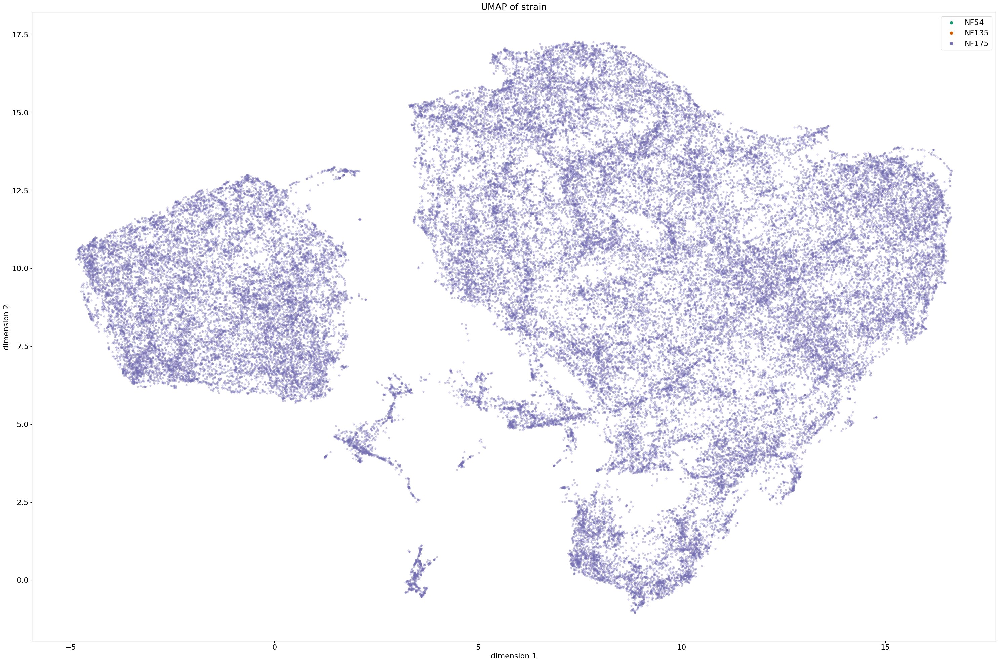

['1s16h' '1s1h' '1s2h' '1s4h' '1s8h' '2s1h' '4s1h' '8s1h']


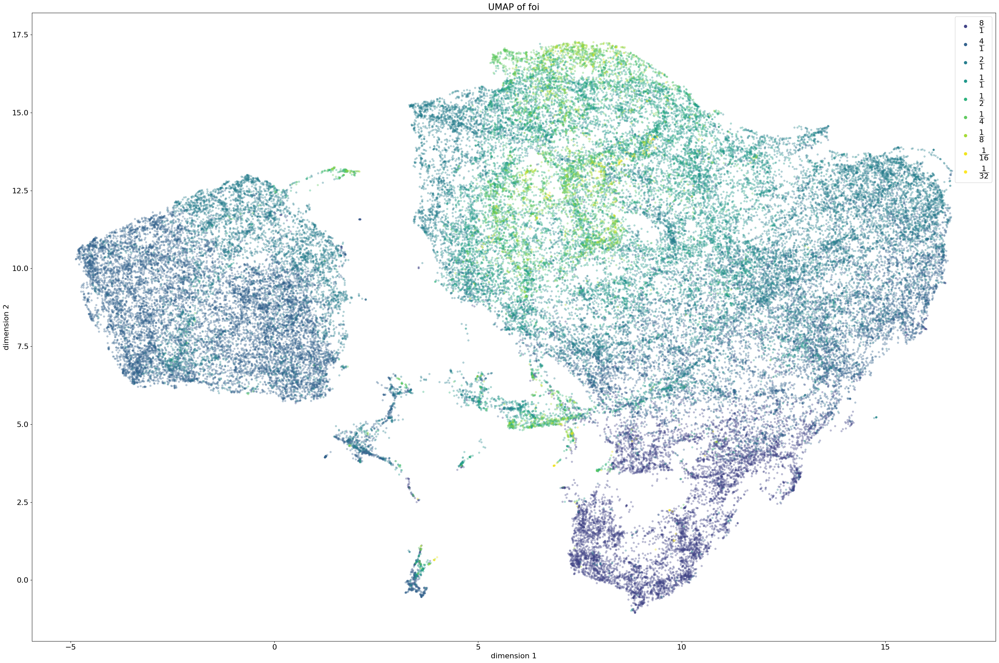

In [22]:
# Dimensionality reduction plotting
for feature in comparison_groups:
    figure_path = os.path.join(paths['FA_latent_space_plots_folder'], '{}_{}-of-{}.png'.format(vae_identifier, dimensionality_reducer.upper(), feature))
    title = '{} of {}'.format(dimensionality_reducer.upper(), feature)
    labels = df[feature]
    print(np.unique(labels))

    plot_lowdim.plot('/mnt/DATA1/anton/pipeline_files/feature_analysis/embeddings/FoI_1_10LD_vanilla-VAE_100epochs_NF175.csv', labels, title=title, save_path=figure_path, show=True, marker_size=marker_size, alpha=alpha, colormap=colormaps[feature], label_settings=label_settings[feature], gradual=gradual[feature])

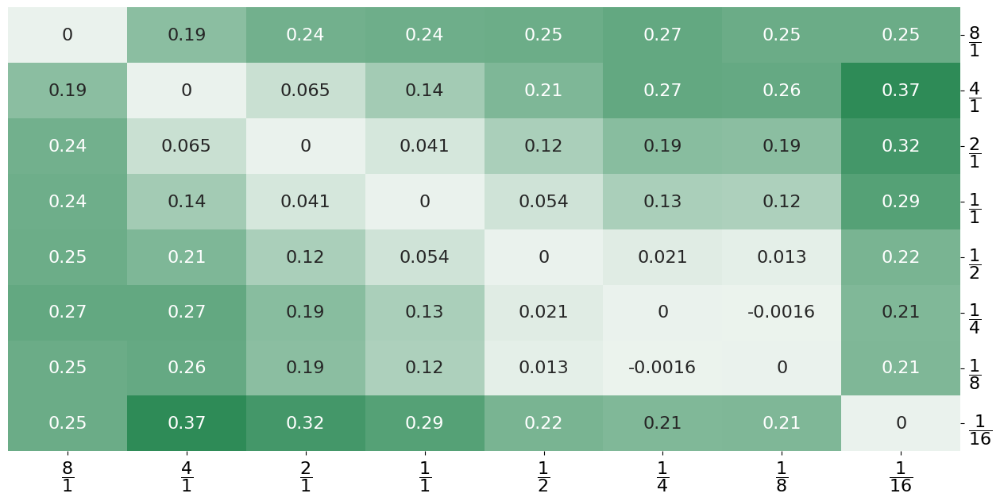

In [25]:
# Generating distance matrices
latent_space_df = pd.read_csv(latent_space_path)
for feature in comparison_groups:
    figure_path = os.path.join(paths['FA_latent_space_matrices_folder'], '{}_silhouette_scores_of_{}.png'.format(vae_identifier, feature))
    labels = [str(l) for l in df[feature]]
    mean, scores = evaluate_clusters.get_sillhouette_scores(latent_space_df, labels)
    ls = label_settings[feature] if label_settings and feature in label_settings.keys() else None
    evaluate_clusters.plot_distance_matrix(scores, show=True, save_path=figure_path, label_settings=ls)

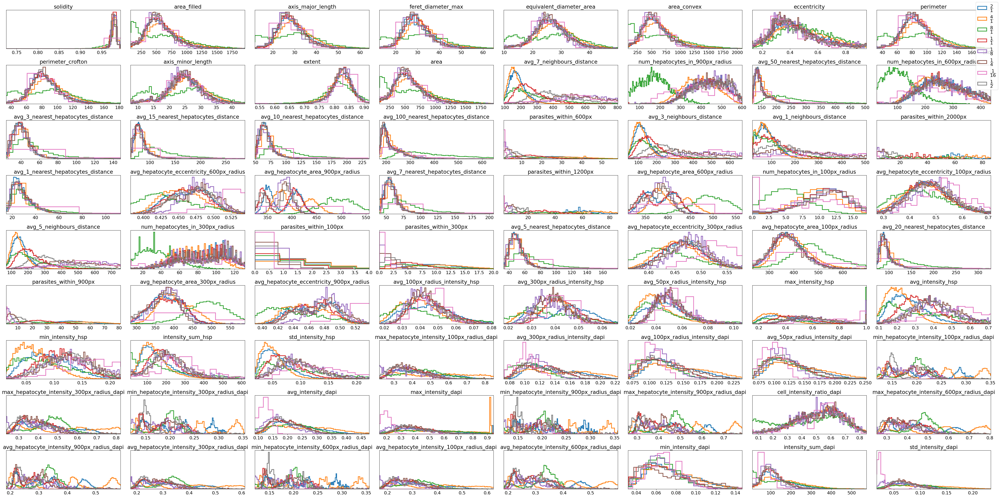

In [26]:

features_df = df.drop(columns=non_feature_columns)

for grouping in comparison_groups:
    labels = df[grouping]
    if label_settings and grouping in label_settings.keys():
        label_settings_dict = {l[0]: l[1] for l in label_settings[grouping]}
        labels = [label_settings_dict[str(l)] for l in labels]
        
    plot_features.multiplot(features=features_df, labels=labels, nrows=9, nbins=120)